In [7]:
import torch
import torchaudio
import matplotlib.pyplot as plt
import IPython.display as ipd
from IPython.display import display, HTML

from src.utils.mel_spec import MelSpectrogram, MelSpectrogramConfig


def show_pair_with_mel(
    path_ref: str,
    path_syn: str,
    title_ref: str = "Reference",
    title_syn: str = "Generated",
    title_diff: str = "Difference |Ref - Gen|",
):
    audio_ref = ipd.Audio(path_ref)
    audio_syn = ipd.Audio(path_syn)

    html = f"""
    <table>
      <tr>
        <th style="text-align:center">{title_ref}</th>
        <th style="text-align:center">{title_syn}</th>
      </tr>
      <tr>
        <td>{audio_ref._repr_html_()}</td>
        <td>{audio_syn._repr_html_()}</td>
      </tr>
    </table>
    """
    display(HTML(html))

    wav_ref, sr_ref = torchaudio.load(path_ref)
    wav_syn, sr_syn = torchaudio.load(path_syn)

    if wav_ref.shape[0] > 1:
        wav_ref = wav_ref.mean(dim=0, keepdim=True)
    if wav_syn.shape[0] > 1:
        wav_syn = wav_syn.mean(dim=0, keepdim=True)

    mel_cfg = MelSpectrogramConfig()
    mel_fn = MelSpectrogram(mel_cfg)

    target_sr = getattr(mel_cfg, "sample_rate", None)

    if target_sr is not None:
        if sr_ref != target_sr:
            wav_ref = torchaudio.functional.resample(wav_ref, sr_ref, target_sr)
        if sr_syn != target_sr:
            wav_syn = torchaudio.functional.resample(wav_syn, sr_syn, target_sr)

    with torch.no_grad():
        spec_ref = mel_fn(wav_ref)[0]
        spec_syn = mel_fn(wav_syn)[0]

    T = min(spec_ref.shape[1], spec_syn.shape[1])
    spec_ref = spec_ref[:, :T]
    spec_syn = spec_syn[:, :T]

    diff = torch.abs(spec_ref - spec_syn)

    vmin = min(spec_ref.min(), spec_syn.min()).item()
    vmax = max(spec_ref.max(), spec_syn.max()).item()

    fig, axes = plt.subplots(1, 3, figsize=(18, 5), sharey=True)

    im0 = axes[0].imshow(
        spec_ref.cpu(),
        origin="lower",
        aspect="auto",
        vmin=vmin,
        vmax=vmax,
    )
    axes[0].set_title(title_ref)
    axes[0].set_xlabel("Frames")
    axes[0].set_ylabel("Mel bins")

    im1 = axes[1].imshow(
        spec_syn.cpu(),
        origin="lower",
        aspect="auto",
        vmin=vmin,
        vmax=vmax,
    )
    axes[1].set_title(title_syn)
    axes[1].set_xlabel("Frames")

    im2 = axes[2].imshow(
        diff.cpu(),
        origin="lower",
        aspect="auto",
        cmap="inferno",
    )
    axes[2].set_title(title_diff)
    axes[2].set_xlabel("Frames")

    fig.colorbar(im0, ax=axes[:2], fraction=0.02, pad=0.02)
    fig.colorbar(im2, ax=axes[2], fraction=0.02, pad=0.02)

    plt.tight_layout()
    plt.show()


# Inner

Reference,Generated


/tmp/ipykernel_67424/767077092.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


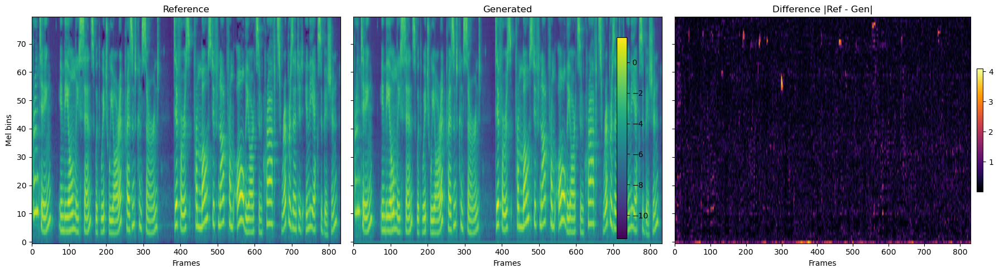

In [8]:
show_pair_with_mel(
    'assets/lj/LJ001-0001.wav',
    'assets/rlj/LJ001-0001.wav',
)

Reference,Generated


/tmp/ipykernel_67424/767077092.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


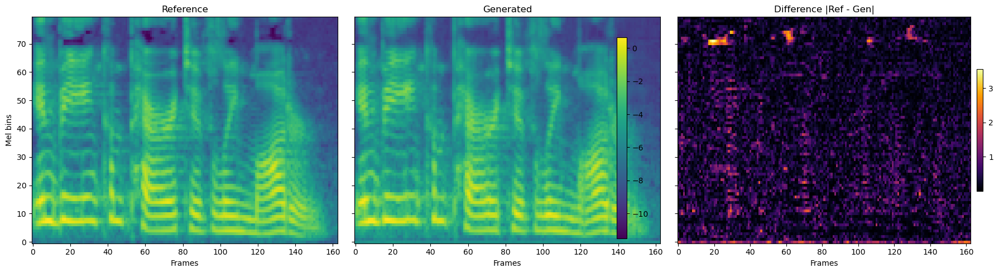

In [9]:
show_pair_with_mel(
    'assets/lj/LJ001-0002.wav',
    'assets/rlj/LJ001-0002.wav',
)

На слух довольно легко определить сгенерированное аудио из за характерных артефактов дрожания голоса. Тем не менее мел спектрограммы очень похожи, но проселживается некоторый патерн. На изображении разности присутствуют очень яркие участи. На этих участках в оригинале происходит резкий разрыв по частоте в то время как на сгенерированных сэмплах все более менее равномерно и плавно. Если мне бы дали 2 мелспектрограммы и сказали что одна из них реальна а другая сгенерированная я бы наверное по этим резким участком смог определить оригинал

# External

Reference,Generated


/tmp/ipykernel_67424/767077092.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


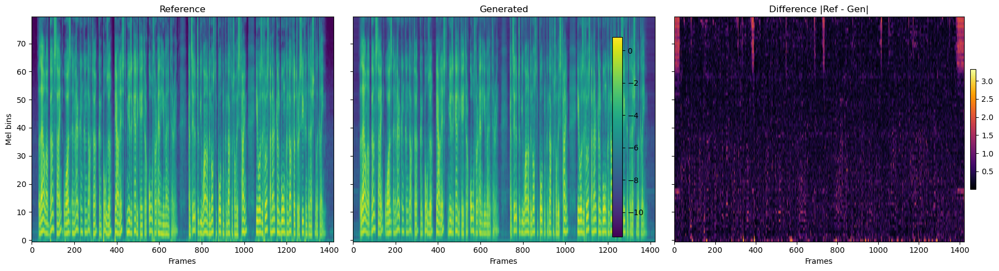

In [10]:
show_pair_with_mel(
    'assets/ext/bernstein.wav',
    'assets/rext/bernstein.wav',
)

Reference,Generated


/tmp/ipykernel_67424/767077092.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


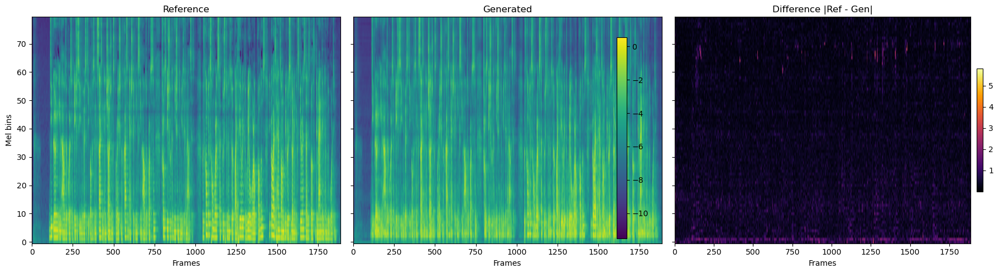

In [11]:
show_pair_with_mel(
    'assets/ext/dla.wav',
    'assets/rext/dla.wav',
)

Стоит отметить что довольно прикольно как модель обобщилась на другие голоса. Я все еще узнаю Макса и Янчика, артефакты правда стали сильнее. Ну и паттерн прослеживается. Особенно корошо видно на второй спеке, она более плавная и дыр нету в верхних частотах в отличии от оригинала.

# Full TTS

Reference,Generated


/tmp/ipykernel_67424/767077092.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


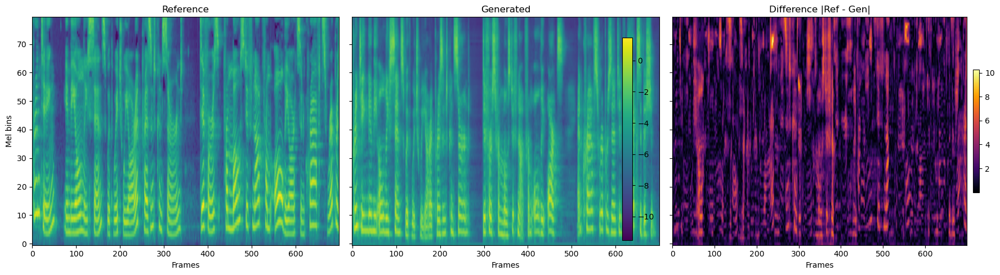

In [12]:
show_pair_with_mel(
    'assets/lj/LJ001-0001.wav',
    'assets/tts_lj/LJ001-0001.wav',
)

Reference,Generated


/tmp/ipykernel_67424/767077092.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


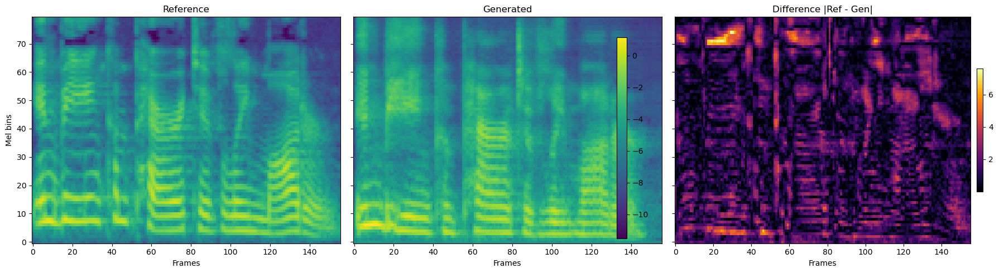

In [13]:
show_pair_with_mel(
    'assets/lj/LJ001-0002.wav',
    'assets/tts_lj/LJ001-0002.wav',
)

Почему-то получился полный ад, очень несоответствуют друг другу. Даже частоты как будто не те и по фазе все разьехалось. Звучит так что параметры мел спектрограммы у такатрона не соответствуют моим, однако вроде соответствуют...

Reference,Generated


/tmp/ipykernel_67424/767077092.py:101: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


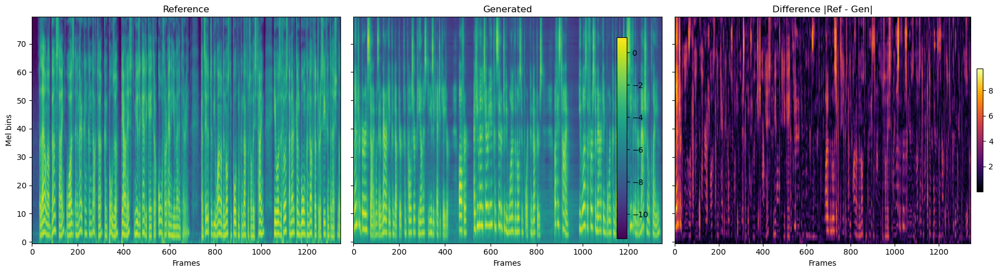

In [14]:
show_pair_with_mel(
    'assets/ext/bernstein.wav',
    'assets/tts_ext/bernstein.wav',
)

Лан ну хотя бы речь разборчива))) Но вообще плачевно конечно